### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

## El comportamiento varía según la variable con la que se haga la regresión no lineal. 
Con la variable "Income", por ej. A partir del degree=4 el score va bajando progresivamente y subiendo el MAE. Con la variable "Age" el score va subiendo progresivamente a medida que sube el degree y el MAE va disminuyendo también progresivamente.

In [1]:
# Import function to create training and test set splits
from sklearn.model_selection import train_test_split
# Import function to automatically create polynomial features! 
from sklearn.preprocessing import PolynomialFeatures
# Import Linear Regression
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.metrics import r2_score, mean_absolute_error

import numpy as np


In [2]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


## Avg.Area Income y Price

In [3]:
# selecciono las dos columnas con las que voy a trabjar y genero oun nuevo dataframe con estas dos columnas
df_Income = df.loc[:,['Avg. Area Income','Price']]

In [4]:
# Test/train split
X_train, X_test, y_train, y_test = train_test_split(df['Avg. Area Income'].values, df['Price'].values, test_size=0.2)

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.4049881779053601
MAE: 218022.35320354137


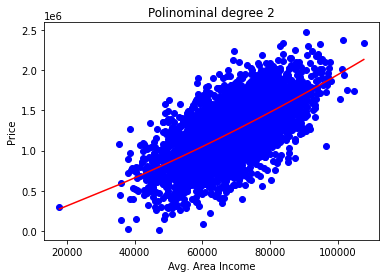

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 3.34869056e+14]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 4.08784948e+14]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 5.68890087e+14]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 2.76224484e+14]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 2.61237052e+14]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 4.21742635e+14]]
(4000, 4)
y_pred (4000,)
Score: 0.4049884109116928
MAE: 218020.13353739714


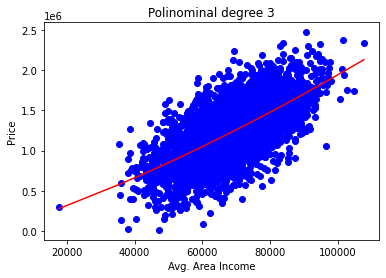

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 3.34869056e+14
  2.32541261e+19]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 4.08784948e+14
  3.03384365e+19]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 5.68890087e+14
  4.71380003e+19]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 2.76224484e+14
  1.79893814e+19]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 2.61237052e+14
  1.66998678e+19]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 4.21742635e+14
  3.16273892e+19]]
(4000, 5)
y_pred (4000,)
Score: 0.405012136695314
MAE: 218011.88364469193


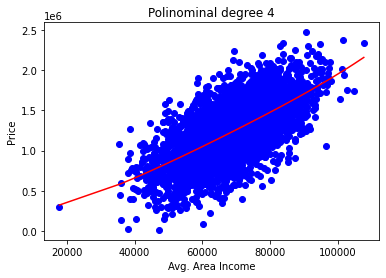

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 3.34869056e+14
  2.32541261e+19 1.61482338e+24]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 4.08784948e+14
  3.03384365e+19 2.25160132e+24]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 5.68890087e+14
  4.71380003e+19 3.90583545e+24]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 2.76224484e+14
  1.79893814e+19 1.17157551e+24]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 2.61237052e+14
  1.66998678e+19 1.06755754e+24]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 4.21742635e+14
  3.16273892e+19 2.37180608e+24]]
(4000, 6)
y_pred (4000,)
Score: 0.404994057734411
MAE: 218011.78196844234


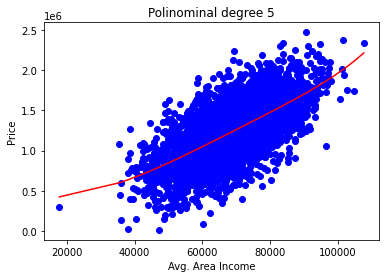

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 ... 2.32541261e+19
  1.61482338e+24 1.12137285e+29]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 ... 3.03384365e+19
  2.25160132e+24 1.67105134e+29]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 ... 4.71380003e+19
  3.90583545e+24 3.23635931e+29]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 ... 1.79893814e+19
  1.17157551e+24 7.62999658e+28]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 ... 1.66998678e+19
  1.06755754e+24 6.82447974e+28]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 ... 3.16273892e+19
  2.37180608e+24 1.77866850e+29]]
(4000, 7)
y_pred (4000,)
Score: 0.4047373519213284
MAE: 218029.41054501056


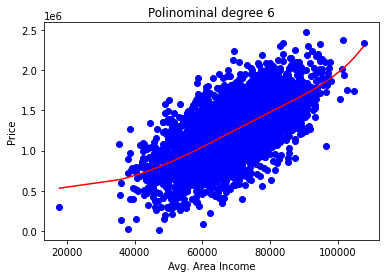

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 ... 1.61482338e+24
  1.12137285e+29 7.78708726e+33]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 ... 2.25160132e+24
  1.67105134e+29 1.24018962e+34]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 ... 3.90583545e+24
  3.23635931e+29 2.68163411e+34]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 ... 1.17157551e+24
  7.62999658e+28 4.96910760e+33]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 ... 1.06755754e+24
  6.82447974e+28 4.36262423e+33]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 ... 2.37180608e+24
  1.77866850e+29 1.33386185e+34]]
(4000, 8)
y_pred (4000,)
Score: 0.403931677571972
MAE: 218148.96005656096


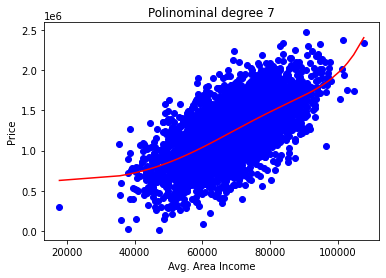

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 ... 1.12137285e+29
  7.78708726e+33 5.40754382e+38]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 ... 1.67105134e+29
  1.24018962e+34 9.20420727e+38]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 ... 3.23635931e+29
  2.68163411e+34 2.22199107e+39]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 ... 7.62999658e+28
  4.96910760e+33 3.23617842e+38]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 ... 6.82447974e+28
  4.36262423e+33 2.78885584e+38]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 ... 1.77866850e+29
  1.33386185e+34 1.00029175e+39]]
(4000, 9)
y_pred (4000,)
Score: 0.40219968887254665
MAE: 218461.91691988762


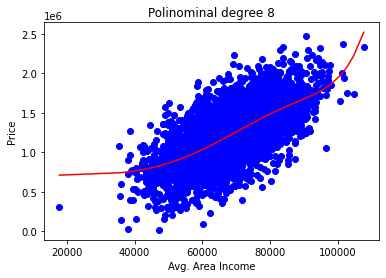

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 ... 7.78708726e+33
  5.40754382e+38 3.75513066e+43]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 ... 1.24018962e+34
  9.20420727e+38 6.83100635e+43]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 ... 2.68163411e+34
  2.22199107e+39 1.84113273e+44]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 ... 4.96910760e+33
  3.23617842e+38 2.10759187e+43]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 ... 4.36262423e+33
  2.78885584e+38 1.78280697e+43]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 ... 1.33386185e+34
  1.00029175e+39 7.50140341e+43]]
(4000, 10)
y_pred (4000,)
Score: 0.39918687199866654
MAE: 219062.14274422821


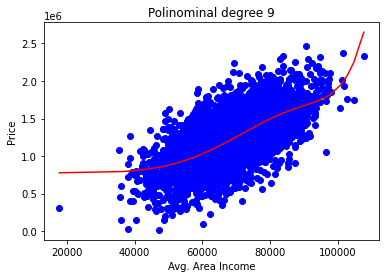

################
[[1.00000000e+00 6.94424454e+04 4.82225322e+09 ... 5.40754382e+38
  3.75513066e+43 2.60765456e+48]
 [1.00000000e+00 7.42161290e+04 5.50803381e+09 ... 9.20420727e+38
  6.83100635e+43 5.06970849e+48]
 [1.00000000e+00 8.28595916e+04 6.86571193e+09 ... 2.22199107e+39
  1.84113273e+44 1.52555506e+49]
 ...
 [1.00000000e+00 6.51259479e+04 4.24138909e+09 ... 3.23617842e+38
  2.10759187e+43 1.37258918e+48]
 [1.00000000e+00 6.39261071e+04 4.08654717e+09 ... 2.78885584e+38
  1.78280697e+43 1.13967909e+48]
 [1.00000000e+00 7.49921553e+04 5.62382336e+09 ... 1.00029175e+39
  7.50140341e+43 5.62546410e+48]]
(4000, 11)
y_pred (4000,)
Score: 0.39462928594148994
MAE: 219907.5578952352


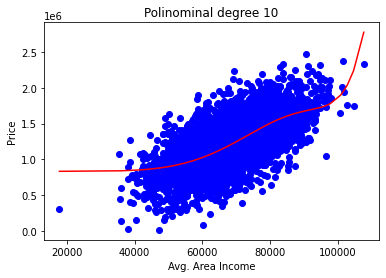

In [5]:
# Definimos nuestra regresión polinomial. Establecemos el rango de la pendiente que vamos a utilizar para ajustar las característias del del polinomio
degree_min = 2
degree_max = 10
# Hacemos la transformacióin polinomial de nuestra variable independiente de entrenamiento
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

# definimos el modelo de regresión

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))
    print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.xlabel('Avg. Area Income')
    plt.ylabel('Price')
    plt.show()
    input("Enter to next grade")

## Avg. Area House Age	y Price

In [6]:
# selecciono las dos columnas con las que voy a trabjar y genero oun nuevo dataframe con estas dos columnas
df_House_Age = df.loc[:,['Avg. Area House Age','Price']]

In [7]:
# Test/train split
X_train, X_test, y_train, y_test = train_test_split(df['Avg. Area House Age'].values, df['Price'].values, test_size=0.2)

################
[[ 1.          4.94453598 24.44843605]
 [ 1.          8.390376   70.39840949]
 [ 1.          7.54560888 56.93621331]
 ...
 [ 1.          5.48613013 30.09762376]
 [ 1.          4.85791355 23.59932407]
 [ 1.          6.93583887 48.10586077]]
(4000, 3)
y_pred (4000,)
Score: 0.21403225581132224
MAE: 250105.34834074133


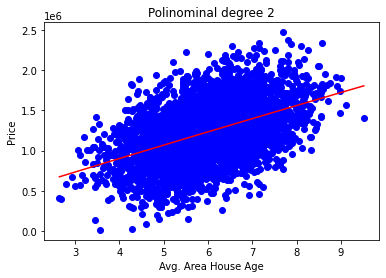

################
[[  1.           4.94453598  24.44843605 120.8861717 ]
 [  1.           8.390376    70.39840949 590.66912566]
 [  1.           7.54560888  56.93621331 429.61839657]
 ...
 [  1.           5.48613013  30.09762376 165.11948046]
 [  1.           4.85791355  23.59932407 114.64347622]
 [  1.           6.93583887  48.10586077 333.65449882]]
(4000, 4)
y_pred (4000,)
Score: 0.2141530831343469
MAE: 250115.99973699515


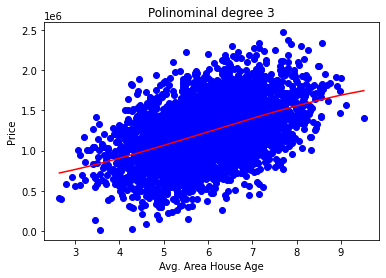

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 1.20886172e+02
  5.97726025e+02]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 5.90669126e+02
  4.95593606e+03]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 4.29618397e+02
  3.24173239e+03]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 1.65119480e+02
  9.05866956e+02]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 1.14643476e+02
  5.56928097e+02]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 3.33654499e+02
  2.31417384e+03]]
(4000, 5)
y_pred (4000,)
Score: 0.2141531026955038
MAE: 250116.10520324679


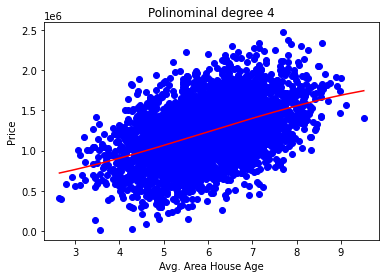

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 1.20886172e+02
  5.97726025e+02 2.95547784e+03]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 5.90669126e+02
  4.95593606e+03 4.15821670e+04]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 4.29618397e+02
  3.24173239e+03 2.44608447e+04]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 1.65119480e+02
  9.05866956e+02 4.96970400e+03]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 1.14643476e+02
  5.56928097e+02 2.70550855e+03]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 3.33654499e+02
  2.31417384e+03 1.60507369e+04]]
(4000, 6)
y_pred (4000,)
Score: 0.2147380222929287
MAE: 249870.4251172616


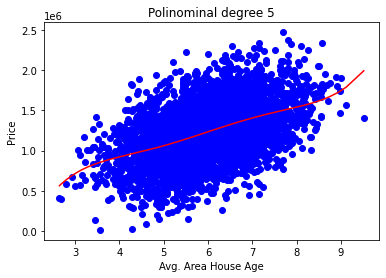

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 ... 5.97726025e+02
  2.95547784e+03 1.46134665e+04]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 ... 4.95593606e+03
  4.15821670e+04 3.48890016e+05]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 ... 3.24173239e+03
  2.44608447e+04 1.84571967e+05]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 ... 9.05866956e+02
  4.96970400e+03 2.72644428e+04]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 ... 5.56928097e+02
  2.70550855e+03 1.31431266e+04]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 ... 2.31417384e+03
  1.60507369e+04 1.11325325e+05]]
(4000, 7)
y_pred (4000,)
Score: 0.2161004202165583
MAE: 249584.29322171197


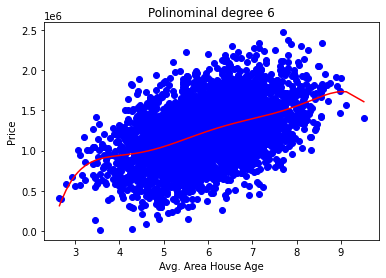

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 ... 2.95547784e+03
  1.46134665e+04 7.22568109e+04]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 ... 4.15821670e+04
  3.48890016e+05 2.92731842e+06]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 ... 2.44608447e+04
  1.84571967e+05 1.39270787e+06]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 ... 4.96970400e+03
  2.72644428e+04 1.49576281e+05]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 ... 2.70550855e+03
  1.31431266e+04 6.38481730e+04]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 ... 1.60507369e+04
  1.11325325e+05 7.72134513e+05]]
(4000, 8)
y_pred (4000,)
Score: 0.21733033488669362
MAE: 249216.35440650364


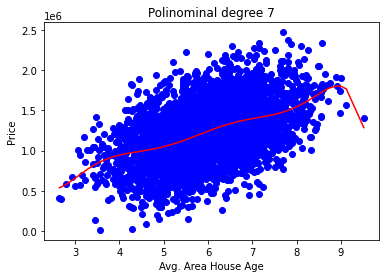

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 ... 1.46134665e+04
  7.22568109e+04 3.57276401e+05]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 ... 3.48890016e+05
  2.92731842e+06 2.45613022e+07]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 ... 1.84571967e+05
  1.39270787e+06 1.05088289e+07]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 ... 2.72644428e+04
  1.49576281e+05 8.20594942e+05]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 ... 1.31431266e+04
  6.38481730e+04 3.10168905e+05]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 ... 1.11325325e+05
  7.72134513e+05 5.35540056e+06]]
(4000, 9)
y_pred (4000,)
Score: 0.2173423212512302
MAE: 249200.90918313127


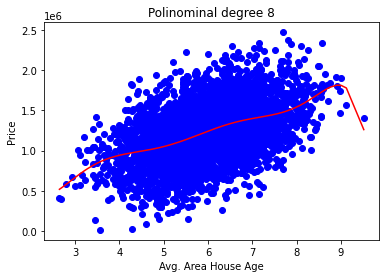

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 ... 7.22568109e+04
  3.57276401e+05 1.76656602e+06]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 ... 2.92731842e+06
  2.45613022e+07 2.06078561e+08]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 ... 1.39270787e+06
  1.05088289e+07 7.92955124e+07]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 ... 1.49576281e+05
  8.20594942e+05 4.50189063e+06]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 ... 6.38481730e+04
  3.10168905e+05 1.50677373e+06]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 ... 7.72134513e+05
  5.35540056e+06 3.71441954e+07]]
(4000, 10)
y_pred (4000,)
Score: 0.21851409672171063
MAE: 248973.34904609472


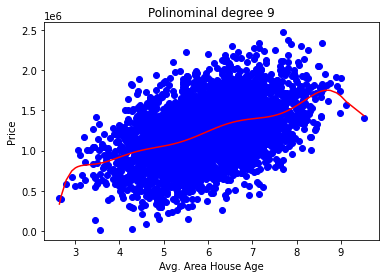

################
[[1.00000000e+00 4.94453598e+00 2.44484361e+01 ... 3.57276401e+05
  1.76656602e+06 8.73484925e+06]
 [1.00000000e+00 8.39037600e+00 7.03984095e+01 ... 2.45613022e+07
  2.06078561e+08 1.72907661e+09]
 [1.00000000e+00 7.54560888e+00 5.69362133e+01 ... 1.05088289e+07
  7.92955124e+07 5.98332922e+08]
 ...
 [1.00000000e+00 5.48613013e+00 3.00976238e+01 ... 8.20594942e+05
  4.50189063e+06 2.46979578e+07]
 [1.00000000e+00 4.85791355e+00 2.35993241e+01 ... 3.10168905e+05
  1.50677373e+06 7.31977650e+06]
 [1.00000000e+00 6.93583887e+00 4.81058608e+01 ... 5.35540056e+06
  3.71441954e+07 2.57626154e+08]]
(4000, 11)
y_pred (4000,)
Score: 0.21856723864028993
MAE: 249003.06517818684


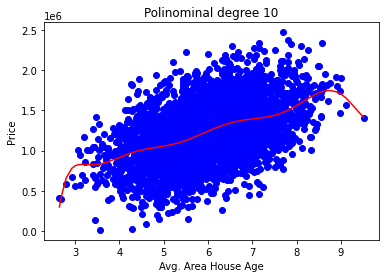

In [8]:
# Definimos nuestra regresión polinomial. Establecemos el rango de la pendiente que vamos a utilizar para ajustar las característias del del polinomio
degree_min = 2
degree_max = 10
# Hacemos la transformación polinomial de nuestra variable independiente de entrenamiento
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

# definimos el modelo de regresión

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))
    print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.xlabel('Avg. Area House Age')
    plt.ylabel('Price')
    plt.show()
    input("Enter to next grade")

## Avg. Area Number of Rooms y Price

In [12]:
# selecciono las dos columnas con las que voy a trabjar y genero oun nuevo dataframe con estas dos columnas
df_Rooms = df.loc[:,['Avg. Area Number of Rooms','Price']]

In [13]:
# Test/train split
X_train, X_test, y_train, y_test = train_test_split(df['Avg. Area Number of Rooms'].values, df['Price'].values, test_size=0.2)

################
[[ 1.          7.73146323 59.77552372]
 [ 1.          6.56402758 43.08645809]
 [ 1.          5.7556199  33.12716046]
 ...
 [ 1.          6.79412183 46.16009142]
 [ 1.          5.91923073 35.03729238]
 [ 1.          6.25796359 39.16210826]]
(4000, 3)
y_pred (4000,)
Score: 0.10744314692935808
MAE: 265964.73624774534


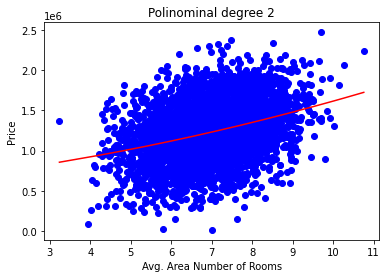

################
[[  1.           7.73146323  59.77552372 462.15226388]
 [  1.           6.56402758  43.08645809 282.82069927]
 [  1.           5.7556199   33.12716046 190.66734406]
 ...
 [  1.           6.79412183  46.16009142 313.61728468]
 [  1.           5.91923073  35.03729238 207.3938176 ]
 [  1.           6.25796359  39.16210826 245.07504745]]
(4000, 4)
y_pred (4000,)
Score: 0.10779879601450693
MAE: 265935.665257538


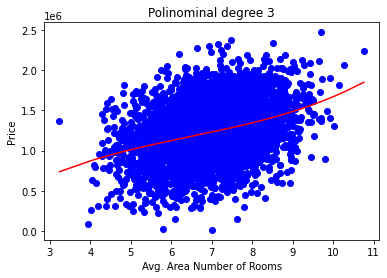

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 4.62152264e+02
  3.57311324e+03]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 2.82820699e+02
  1.85644287e+03]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 1.90667344e+02
  1.09740876e+03]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 3.13617285e+02
  2.13075404e+03]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 2.07393818e+02
  1.22761186e+03]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 2.45075047e+02
  1.53367072e+03]]
(4000, 5)
y_pred (4000,)
Score: 0.10823838870179225
MAE: 265841.75348009216


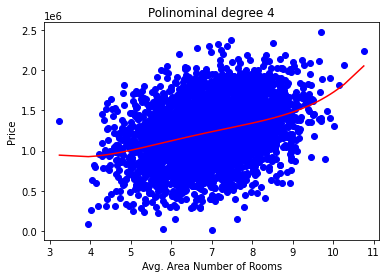

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 4.62152264e+02
  3.57311324e+03 2.76253936e+04]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 2.82820699e+02
  1.85644287e+03 1.21857422e+04]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 1.90667344e+02
  1.09740876e+03 6.31626770e+03]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 3.13617285e+02
  2.13075404e+03 1.44766025e+04]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 2.07393818e+02
  1.22761186e+03 7.26651783e+03]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 2.45075047e+02
  1.53367072e+03 9.59765554e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.10825440531771435
MAE: 265831.37820784235


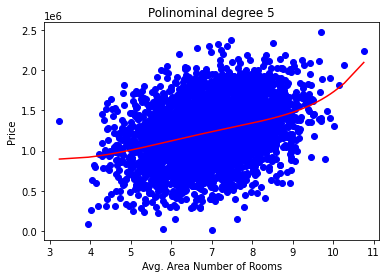

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 ... 3.57311324e+03
  2.76253936e+04 2.13584715e+05]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 ... 1.85644287e+03
  1.21857422e+04 7.99875479e+04]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 ... 1.09740876e+03
  6.31626770e+03 3.63540361e+04]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 ... 2.13075404e+03
  1.44766025e+04 9.83558012e+04]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 ... 1.22761186e+03
  7.26651783e+03 4.30121956e+04]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 ... 1.53367072e+03
  9.59765554e+03 6.00617789e+04]]
(4000, 7)
y_pred (4000,)
Score: 0.10847611801935886
MAE: 265801.44382500864


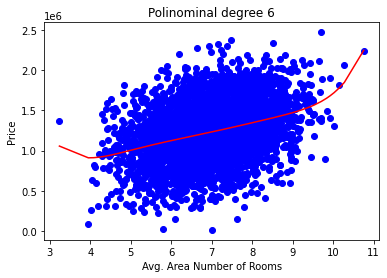

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 ... 2.76253936e+04
  2.13584715e+05 1.65132237e+06]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 ... 1.21857422e+04
  7.99875479e+04 5.25040471e+05]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 ... 6.31626770e+03
  3.63540361e+04 2.09240014e+05]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 ... 1.44766025e+04
  9.83558012e+04 6.68241296e+05]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 ... 7.26651783e+03
  4.30121956e+04 2.54599110e+05]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 ... 9.59765554e+03
  6.00617789e+04 3.75864425e+05]]
(4000, 8)
y_pred (4000,)
Score: 0.10855701172706278
MAE: 265797.45543897577


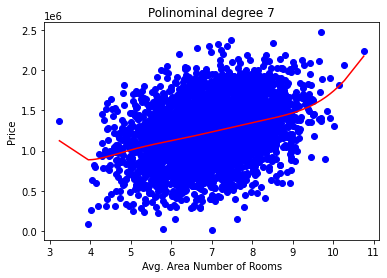

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 ... 2.13584715e+05
  1.65132237e+06 1.27671382e+07]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 ... 7.99875479e+04
  5.25040471e+05 3.44638013e+06]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 ... 3.63540361e+04
  2.09240014e+05 1.20430599e+06]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 ... 9.83558012e+04
  6.68241296e+05 4.54011278e+06]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 ... 4.30121956e+04
  2.54599110e+05 1.50703087e+06]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 ... 6.00617789e+04
  3.75864425e+05 2.35214589e+06]]
(4000, 9)
y_pred (4000,)
Score: 0.109244499792012
MAE: 265642.9804432592


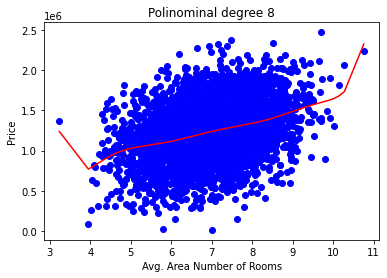

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 ... 1.65132237e+06
  1.27671382e+07 9.87086596e+07]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 ... 5.25040471e+05
  3.44638013e+06 2.26221342e+07]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 ... 2.09240014e+05
  1.20430599e+06 6.93152751e+06]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 ... 6.68241296e+05
  4.54011278e+06 3.08460793e+07]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 ... 2.54599110e+05
  1.50703087e+06 8.92046344e+06]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 ... 3.75864425e+05
  2.35214589e+06 1.47196433e+07]]
(4000, 10)
y_pred (4000,)
Score: 0.11006475321435627
MAE: 265508.25803142186


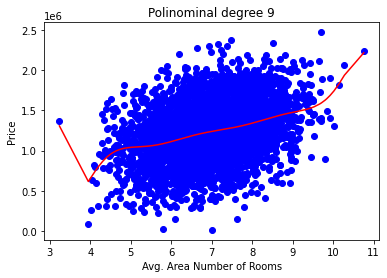

################
[[1.00000000e+00 7.73146323e+00 5.97755237e+01 ... 1.27671382e+07
  9.87086596e+07 7.63162372e+08]
 [1.00000000e+00 6.56402758e+00 4.30864581e+01 ... 3.44638013e+06
  2.26221342e+07 1.48492313e+08]
 [1.00000000e+00 5.75561990e+00 3.31271605e+01 ... 1.20430599e+06
  6.93152751e+06 3.98952377e+07]
 ...
 [1.00000000e+00 6.79412183e+00 4.61600914e+01 ... 4.54011278e+06
  3.08460793e+07 2.09572021e+08]
 [1.00000000e+00 5.91923073e+00 3.50372924e+01 ... 1.50703087e+06
  8.92046344e+06 5.28022813e+07]
 [1.00000000e+00 6.25796359e+00 3.91621083e+01 ... 2.35214589e+06
  1.47196433e+07 9.21149918e+07]]
(4000, 11)
y_pred (4000,)
Score: 0.11060346730914916
MAE: 265533.1743270097


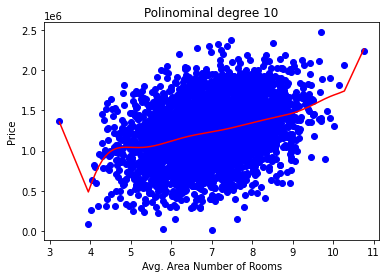

In [14]:
# Definimos nuestra regresión polinomial. Establecemos el rango de la pendiente que vamos a utilizar para ajustar las característias del del polinomio
degree_min = 2
degree_max = 10
# Hacemos la transformación polinomial de nuestra variable independiente de entrenamiento
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

# definimos el modelo de regresión

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))
    print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.xlabel('Avg. Area Number of Rooms')
    plt.ylabel('Price')
    plt.show()
    input("Enter to next grade")

## Avg. Area Number of Bedrooms	y Price

In [26]:
# selecciono las dos columnas con las que voy a trabjar y genero oun nuevo dataframe con estas dos columnas
df_Bedrooms = df.loc[:,['Avg. Area Number of Bedrooms','Price']]

In [28]:
# Test/train split
X_train, X_test, y_train, y_test = train_test_split(df['Avg. Area Number of Bedrooms'].values, df['Price'].values, test_size=0.2)

################
[[ 1.      4.04   16.3216]
 [ 1.      3.26   10.6276]
 [ 1.      3.      9.    ]
 ...
 [ 1.      4.16   17.3056]
 [ 1.      3.15    9.9225]
 [ 1.      5.17   26.7289]]
(4000, 3)
y_pred (4000,)
Score: 0.027361603727377615
MAE: 277157.0522707446


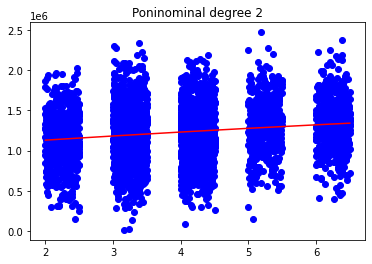

################
[[  1.         4.04      16.3216    65.939264]
 [  1.         3.26      10.6276    34.645976]
 [  1.         3.         9.        27.      ]
 ...
 [  1.         4.16      17.3056    71.991296]
 [  1.         3.15       9.9225    31.255875]
 [  1.         5.17      26.7289   138.188413]]
(4000, 4)
y_pred (4000,)
Score: 0.02736902105938166
MAE: 277151.16474105243


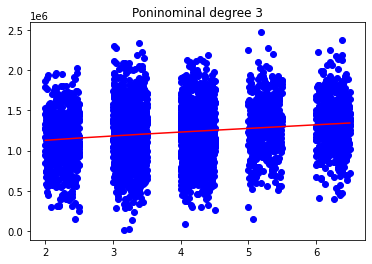

################
[[  1.           4.04        16.3216      65.939264   266.39462656]
 [  1.           3.26        10.6276      34.645976   112.94588176]
 [  1.           3.           9.          27.          81.        ]
 ...
 [  1.           4.16        17.3056      71.991296   299.48379136]
 [  1.           3.15         9.9225      31.255875    98.45600625]
 [  1.           5.17        26.7289     138.188413   714.43409521]]
(4000, 5)
y_pred (4000,)
Score: 0.030373353584158158
MAE: 276773.05460565456


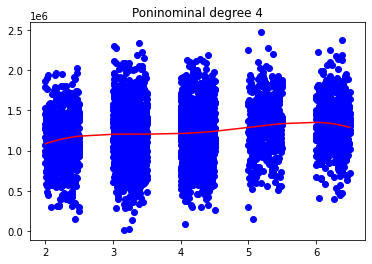

################
[[1.00000000e+00 4.04000000e+00 1.63216000e+01 6.59392640e+01
  2.66394627e+02 1.07623429e+03]
 [1.00000000e+00 3.26000000e+00 1.06276000e+01 3.46459760e+01
  1.12945882e+02 3.68203575e+02]
 [1.00000000e+00 3.00000000e+00 9.00000000e+00 2.70000000e+01
  8.10000000e+01 2.43000000e+02]
 ...
 [1.00000000e+00 4.16000000e+00 1.73056000e+01 7.19912960e+01
  2.99483791e+02 1.24585257e+03]
 [1.00000000e+00 3.15000000e+00 9.92250000e+00 3.12558750e+01
  9.84560062e+01 3.10136420e+02]
 [1.00000000e+00 5.17000000e+00 2.67289000e+01 1.38188413e+02
  7.14434095e+02 3.69362427e+03]]
(4000, 6)
y_pred (4000,)
Score: 0.03062722221025138
MAE: 276778.9383514981


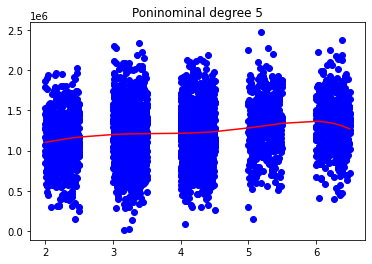

################
[[1.00000000e+00 4.04000000e+00 1.63216000e+01 ... 2.66394627e+02
  1.07623429e+03 4.34798654e+03]
 [1.00000000e+00 3.26000000e+00 1.06276000e+01 ... 1.12945882e+02
  3.68203575e+02 1.20034365e+03]
 [1.00000000e+00 3.00000000e+00 9.00000000e+00 ... 8.10000000e+01
  2.43000000e+02 7.29000000e+02]
 ...
 [1.00000000e+00 4.16000000e+00 1.73056000e+01 ... 2.99483791e+02
  1.24585257e+03 5.18274670e+03]
 [1.00000000e+00 3.15000000e+00 9.92250000e+00 ... 9.84560062e+01
  3.10136420e+02 9.76929722e+02]
 [1.00000000e+00 5.17000000e+00 2.67289000e+01 ... 7.14434095e+02
  3.69362427e+03 1.90960375e+04]]
(4000, 7)
y_pred (4000,)
Score: 0.03145721776880528
MAE: 276643.0857720846


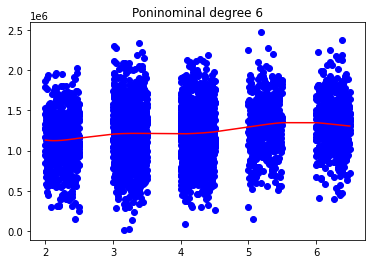

################
[[1.00000000e+00 4.04000000e+00 1.63216000e+01 ... 1.07623429e+03
  4.34798654e+03 1.75658656e+04]
 [1.00000000e+00 3.26000000e+00 1.06276000e+01 ... 3.68203575e+02
  1.20034365e+03 3.91312031e+03]
 [1.00000000e+00 3.00000000e+00 9.00000000e+00 ... 2.43000000e+02
  7.29000000e+02 2.18700000e+03]
 ...
 [1.00000000e+00 4.16000000e+00 1.73056000e+01 ... 1.24585257e+03
  5.18274670e+03 2.15602263e+04]
 [1.00000000e+00 3.15000000e+00 9.92250000e+00 ... 3.10136420e+02
  9.76929722e+02 3.07732862e+03]
 [1.00000000e+00 5.17000000e+00 2.67289000e+01 ... 3.69362427e+03
  1.90960375e+04 9.87265138e+04]]
(4000, 8)
y_pred (4000,)
Score: 0.031505447609042836
MAE: 276643.5936080008


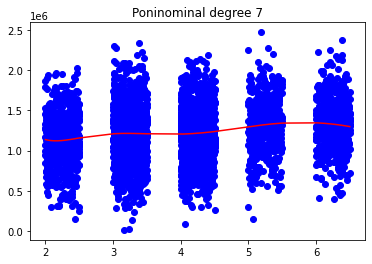

################
[[1.00000000e+00 4.04000000e+00 1.63216000e+01 ... 4.34798654e+03
  1.75658656e+04 7.09660971e+04]
 [1.00000000e+00 3.26000000e+00 1.06276000e+01 ... 1.20034365e+03
  3.91312031e+03 1.27567722e+04]
 [1.00000000e+00 3.00000000e+00 9.00000000e+00 ... 7.29000000e+02
  2.18700000e+03 6.56100000e+03]
 ...
 [1.00000000e+00 4.16000000e+00 1.73056000e+01 ... 5.18274670e+03
  2.15602263e+04 8.96905413e+04]
 [1.00000000e+00 3.15000000e+00 9.92250000e+00 ... 9.76929722e+02
  3.07732862e+03 9.69358517e+03]
 [1.00000000e+00 5.17000000e+00 2.67289000e+01 ... 1.90960375e+04
  9.87265138e+04 5.10416076e+05]]
(4000, 9)
y_pred (4000,)
Score: 0.031579669068300786
MAE: 276605.3463900682


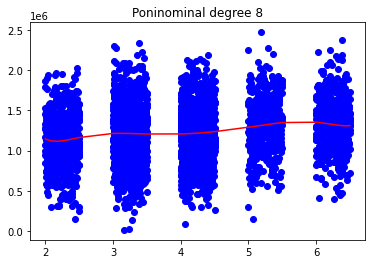

################
[[1.00000000e+00 4.04000000e+00 1.63216000e+01 ... 1.75658656e+04
  7.09660971e+04 2.86703032e+05]
 [1.00000000e+00 3.26000000e+00 1.06276000e+01 ... 3.91312031e+03
  1.27567722e+04 4.15870774e+04]
 [1.00000000e+00 3.00000000e+00 9.00000000e+00 ... 2.18700000e+03
  6.56100000e+03 1.96830000e+04]
 ...
 [1.00000000e+00 4.16000000e+00 1.73056000e+01 ... 2.15602263e+04
  8.96905413e+04 3.73112652e+05]
 [1.00000000e+00 3.15000000e+00 9.92250000e+00 ... 3.07732862e+03
  9.69358517e+03 3.05347933e+04]
 [1.00000000e+00 5.17000000e+00 2.67289000e+01 ... 9.87265138e+04
  5.10416076e+05 2.63885111e+06]]
(4000, 10)
y_pred (4000,)
Score: 0.03175510389435865
MAE: 276643.1102415037


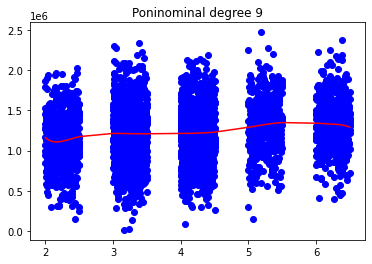

################
[[1.00000000e+00 4.04000000e+00 1.63216000e+01 ... 7.09660971e+04
  2.86703032e+05 1.15828025e+06]
 [1.00000000e+00 3.26000000e+00 1.06276000e+01 ... 1.27567722e+04
  4.15870774e+04 1.35573872e+05]
 [1.00000000e+00 3.00000000e+00 9.00000000e+00 ... 6.56100000e+03
  1.96830000e+04 5.90490000e+04]
 ...
 [1.00000000e+00 4.16000000e+00 1.73056000e+01 ... 8.96905413e+04
  3.73112652e+05 1.55214863e+06]
 [1.00000000e+00 3.15000000e+00 9.92250000e+00 ... 9.69358517e+03
  3.05347933e+04 9.61845988e+04]
 [1.00000000e+00 5.17000000e+00 2.67289000e+01 ... 5.10416076e+05
  2.63885111e+06 1.36428603e+07]]
(4000, 11)
y_pred (4000,)
Score: 0.03190486262790437
MAE: 276658.9165632937


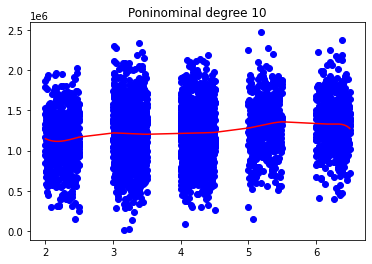

In [29]:
# Definimos nuestra regresión polinomial. Establecemos el rango de la pendiente que vamos a utilizar para ajustar las característias del del polinomio
degree_min = 2
degree_max = 10
# Hacemos la transformación polinomial de nuestra variable independiente de entrenamiento
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

# definimos el modelo de regresión

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))
    print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.xlabel('Avg. Area Number of Bedrooms')
    plt.ylabel('Price')
    plt.show()
    input("Enter to next grade")

## Area Population	y Price

In [33]:
# selecciono las dos columnas con las que voy a trabjar y genero oun nuevo dataframe con estas dos columnas
df_Population = df.loc[:,['Area Population','Price']]

In [34]:
# Test/train split
X_train, X_test, y_train, y_test = train_test_split(df['Area Population'].values, df['Price'].values, test_size=0.2)

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09]]
(4000, 3)
y_pred (4000,)
Score: 0.16053892746435872
MAE: 256769.8916012005


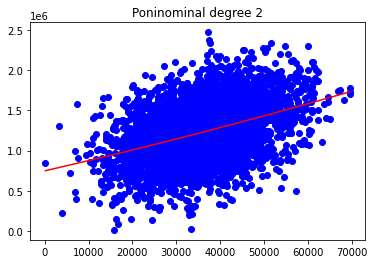

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 3.72198330e+13]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 4.07173578e+13]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 4.74975495e+13]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 2.73085160e+13]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 5.31759601e+13]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 9.92372924e+13]]
(4000, 4)
y_pred (4000,)
Score: 0.16054813509932808
MAE: 256775.39163116209


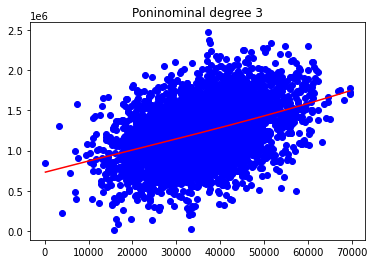

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 3.72198330e+13
  1.24269884e+18]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 4.07173578e+13
  1.40078920e+18]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 4.74975495e+13
  1.72013133e+18]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 2.73085160e+13
  8.22364081e+17]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 5.31759601e+13
  1.99964907e+18]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 9.92372924e+13
  4.59444660e+18]]
(4000, 5)
y_pred (4000,)
Score: 0.16049143015452128
MAE: 256790.66598810285


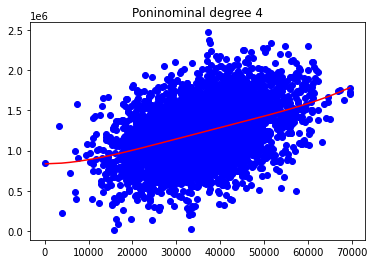

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 3.72198330e+13
  1.24269884e+18 4.14913310e+22]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 4.07173578e+13
  1.40078920e+18 4.81910047e+22]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 4.74975495e+13
  1.72013133e+18 6.22948303e+22]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 2.73085160e+13
  8.22364081e+17 2.47645343e+22]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 5.31759601e+13
  1.99964907e+18 7.51955660e+22]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 9.92372924e+13
  4.59444660e+18 2.12711765e+23]]
(4000, 6)
y_pred (4000,)
Score: 0.159812036978222
MAE: 256927.97892084077


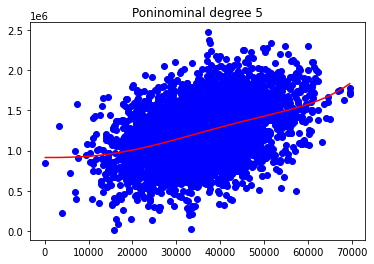

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 ... 1.24269884e+18
  4.14913310e+22 1.38531597e+27]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 ... 1.40078920e+18
  4.81910047e+22 1.65790323e+27]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 ... 1.72013133e+18
  6.22948303e+22 2.25601721e+27]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 ... 8.22364081e+17
  2.47645343e+22 7.45755044e+26]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 ... 1.99964907e+18
  7.51955660e+22 2.82768273e+27]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 ... 4.59444660e+18
  2.12711765e+23 9.84804021e+27]]
(4000, 7)
y_pred (4000,)
Score: 0.15816679535491596
MAE: 257195.48962336636


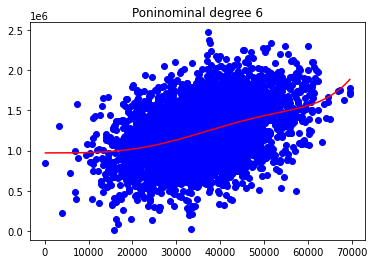

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 ... 4.14913310e+22
  1.38531597e+27 4.62530433e+31]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 ... 4.81910047e+22
  1.65790323e+27 5.70364350e+31]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 ... 6.22948303e+22
  2.25601721e+27 8.17020229e+31]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 ... 2.47645343e+22
  7.45755044e+26 2.24575426e+31]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 ... 7.51955660e+22
  2.82768273e+27 1.06333259e+32]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 ... 2.12711765e+23
  9.84804021e+27 4.55940441e+32]]
(4000, 8)
y_pred (4000,)
Score: 0.1553668306265028
MAE: 257585.7332391877


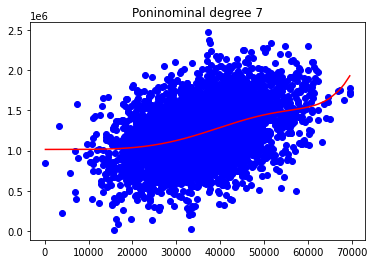

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 ... 1.38531597e+27
  4.62530433e+31 1.54430041e+36]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 ... 1.65790323e+27
  5.70364350e+31 1.96221038e+36]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 ... 2.25601721e+27
  8.17020229e+31 2.95885178e+36]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 ... 7.45755044e+26
  2.24575426e+31 6.76282681e+35]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 ... 2.82768273e+27
  1.06333259e+32 3.99859642e+36]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 ... 9.84804021e+27
  4.55940441e+32 2.11089396e+37]]
(4000, 9)
y_pred (4000,)
Score: 0.15137286419795148
MAE: 258112.38781790805


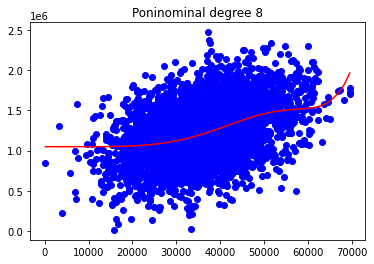

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 ... 4.62530433e+31
  1.54430041e+36 5.15612290e+40]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 ... 5.70364350e+31
  1.96221038e+36 6.75054389e+40]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 ... 8.17020229e+31
  2.95885178e+36 1.07155289e+41]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 ... 2.24575426e+31
  6.76282681e+35 2.03654635e+40]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 ... 1.06333259e+32
  3.99859642e+36 1.50364744e+41]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 ... 4.55940441e+32
  2.11089396e+37 9.77292846e+41]]
(4000, 10)
y_pred (4000,)
Score: 0.14626531299442036
MAE: 258791.29422998094


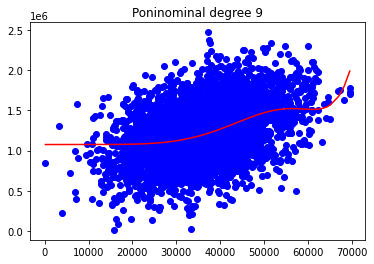

################
[[1.00000000e+00 3.33880821e+04 1.11476403e+09 ... 1.54430041e+36
  5.15612290e+40 1.72153055e+45]
 [1.00000000e+00 3.44027529e+04 1.18354941e+09 ... 1.96221038e+36
  6.75054389e+40 2.32237293e+45]
 [1.00000000e+00 3.62151594e+04 1.31153777e+09 ... 2.95885178e+36
  1.07155289e+41 3.88064588e+45]
 ...
 [1.00000000e+00 3.01138327e+04 9.06842920e+08 ... 6.76282681e+35
  2.03654635e+40 6.13282161e+44]
 [1.00000000e+00 3.76043812e+04 1.41408949e+09 ... 3.99859642e+36
  1.50364744e+41 5.65437315e+45]
 [1.00000000e+00 4.62975812e+04 2.14346603e+09 ... 2.11089396e+37
  9.77292846e+41 4.52462949e+46]]
(4000, 11)
y_pred (4000,)
Score: 0.14019911106218108
MAE: 259671.3596813107


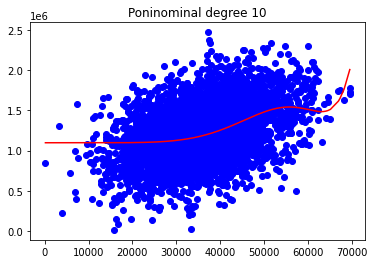

In [35]:
# Definimos nuestra regresión polinomial. Establecemos el rango de la pendiente que vamos a utilizar para ajustar las característias del del polinomio
degree_min = 2
degree_max = 10
# Hacemos la transformación polinomial de nuestra variable independiente de entrenamiento
scores = []
for degree in range(degree_min,degree_max+1):
    print("################")
    polinominal_model = PolynomialFeatures(degree) 
    X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

    #######
    print(X_poly)
    print(X_poly.shape)

# definimos el modelo de regresión

    lin_reg_model = LinearRegression()
    lin_reg_model.fit(X_poly, y_train)
    y_pred = lin_reg_model.predict(X_poly)

    print("y_pred", y_pred.shape)
    print("Score:", r2_score(y_train, y_pred))
    print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
    X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
    plt.scatter(X_train_to_show, y_train_to_show, color='b')
    X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
    plt.plot(X_train_to_show, y_pred, color='red')
    plt.title("Polinominal degree " + str(degree))
    plt.xlabel('Area Population')
    plt.ylabel('Price')
    plt.show()
    input("Enter to next grade")